# Konnektor - Building Ligand Networks

The Konnektor library provides frames for building different types of Networks. It is designed with the context of Free Energy Calculations in mind, enabling the design of complex alchemical campaigns.

This notebook demonstrates how Konnektor can be used to create various different types of Networks.


In [ ]:
# NBVAL_SKIP
# Only run this cell if on google colab
import os

if "COLAB_RELEASE_TAG" in os.environ:
    !pip install -U https://github.com/conda-incubator/condacolab/archive/cuda-version-12.tar.gz
    import condacolab

    condacolab.install_mambaforge()
    !wget -q https://raw.githubusercontent.com/OpenFreeEnergy/konnektor/main/examples/environment.yaml
    !mamba env update -q --name=base --file=environment.yaml

from google.colab import output

output.enable_custom_widget_manager()

## 1. Simple Network Examples

In this section we will have a first look at the basic functionality of Konnektor, demonstrating how to construct Networks. For a more detailed look on the Networks, please have a look at the [konnektor_networks notebook](https://github.com/OpenFreeEnergy/konnektor/blob/main/examples/konnektor_networks.ipynb).

### Build up randomized data:

First we will generate a randomized dataset of Molecules (`Component`s), alongside an `AtomMapper` and `AtomMappingScorer` specifically generated for this toy dataset. The `AtomMapper` in our case is an \"edge generator\" allowing us to create all possible edges (`AtomMapping`s) for the set of `Component`s. The `AtomMappingScorer` simply adds the score (weight) information to the generated edges. In theory, this score is an estimate of the difficulty in transforming `Component` A to `Component` B. This score can therefore be used to try to find the best transformation paths through all the `AtomMapping`s.

In [1]:
from konnektor.utils import toy_data

components, mapper, scorer = toy_data.build_random_dataset(
    n_compounds=20, rand_seed=42
)

### Star Network Layout

The  __Star Network Layout__  is one of the simplest Network layouts. Whilst not optimal, it is efficient and reasonably robust, losing only one `Component` comparison should an edge fail. Its main limitation is the choice of the central ligand, which affects the quality of all the Network's results.

The __Star Network Layout__ can be very easily generated using the `StarNetworkGenerator`. To create it, we pass the `AtomMapper` and the `AtomMappingScorer` as settings to the generator as they are required for building the possible edges and their associated weights. This concept will repeat for all the network generators in Konnektor.

**Note:** You can use the `n_processes` flag to parallelize the network generation using multiple CPUs.

In [2]:
from konnektor.network_planners import StarNetworkGenerator

network_planner = StarNetworkGenerator(
    mappers=mapper, scorer=scorer, n_processes=1
)

Next the network is created by calling an instance of the `StarNetworkGenerator` passing in the `Component`s we want to connect.

For ease of use, we add a name to the generated object by setting the `name` attribute.

In [3]:
radial_network = network_planner.generate_ligand_network(components)
radial_network.name = "Star Network"
radial_network

<LigandNetwork-6f02ab0b8727200dbefbc5cba91c1176>

**Note:** here the `StarNetworkGenerator` automatically selects the central `Component` by finding the average best score-performing `Component`. You could also pass your own desired central `Component` by setting the `central_component` argument when calling the `StarNetworkGenerator` instance.

Finally let's have a look at the network we generated, this can be done using the `draw_ligand_network` function from Konnektor. The function returns a matplotlib `Figure`, which can be easily stored as a figure with:

```python
    fig.savefig("./star_network.png")
```

**Note:** The colors indicate the relative connectivity. *Green* `Component`s have an average number of connections, *red* `Component`s have higher than average connectivity.

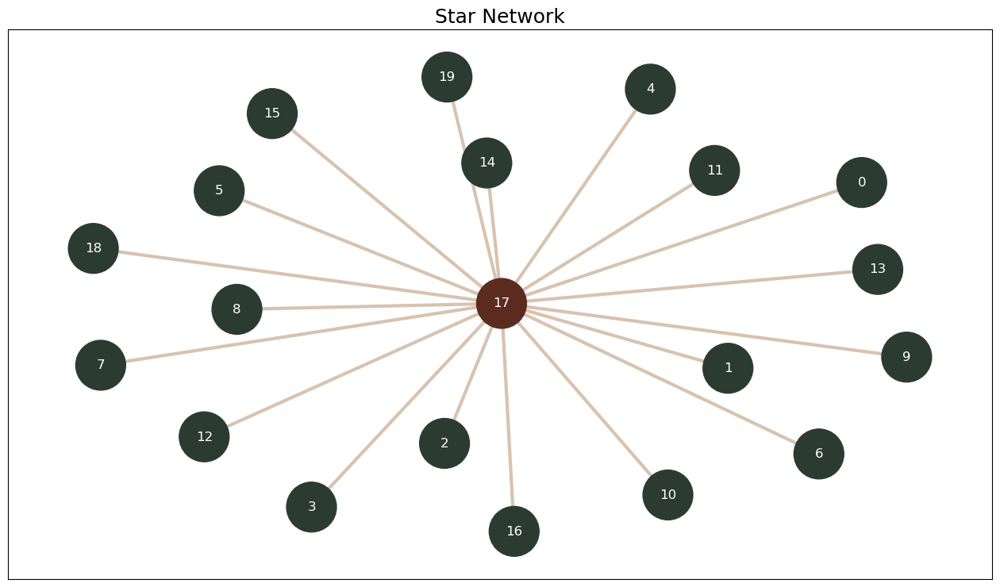

In [4]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network

fig = draw_ligand_network(radial_network, title=radial_network.name)

### Cyclic Network Layout
In a next step, let's switch the the network layout. The `CyclicNetworkGenerator` works exactly the same manner as the `StarNetworkGenerator`, but generates Networks with a __Cyclic Network Layout__.

This network layout focuses on generating a graph containing a large set of cycles, adding extra redundancies and allowing for cycle closure analysis.

In [5]:
from konnektor.network_planners import CyclicNetworkGenerator

network_planner = CyclicNetworkGenerator(mappers=mapper, scorer=scorer)

In [6]:
cyclic_network = network_planner.generate_ligand_network(components)
cyclic_network.name = "Cyclic Network"
cyclic_network

<LigandNetwork-04e0a0acc36cffa0de52a4f76267e56b>

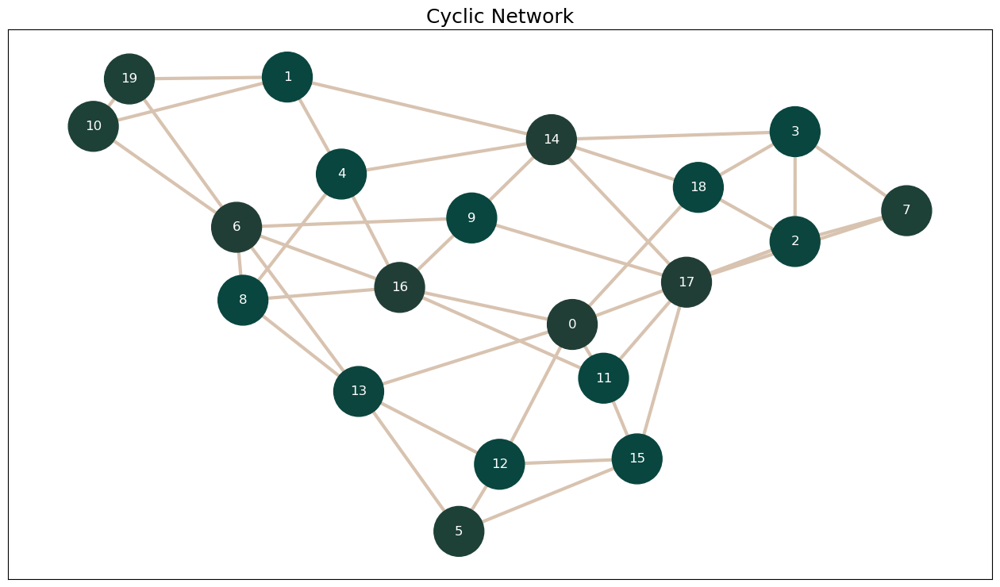

In [7]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network

fig = draw_ligand_network(cyclic_network, title=cyclic_network.name);

### Starry Sky Network Layout
The __Starry Sky Network__ layout is an extension of the __Star Network__ layout which tries to circumvent the issue of finding an optimal central molecule by clustering the molecules around multiple central molecules, connecting each central molecule as necessary. Compared to a standard __Star Network__, this topology is less robust when it comes to edge failure but reduces the risk of high cost edges, and therefore edge failure, when combined with a good scoring function.

This network is generated in three steps:
1. Cluster the input list of `Components` based on the class passed to the `clusterer` argument. By default this uses an instance of the `ComponentsDiversityClusterer` which clusters input Components by their Morgan fingerprints.
2. In each cluster build a sub-network, here with the __Star Network Layout__.
3. Concatenate the star networks with the two best edges between each of the clusters.


In [8]:
from konnektor.network_planners import StarrySkyNetworkGenerator

network_planner = StarrySkyNetworkGenerator(mappers=mapper, scorer=scorer)

In [9]:
starry_sky_network = network_planner.generate_ligand_network(components)
starry_sky_network.name = "Starry Sky Network"
starry_sky_network

[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerator
[18:49:30] DEPRECATION WARNING: please use MorganGenerat

<LigandNetwork-d1e07f925febf6b923d0bc57f35b6f7d>

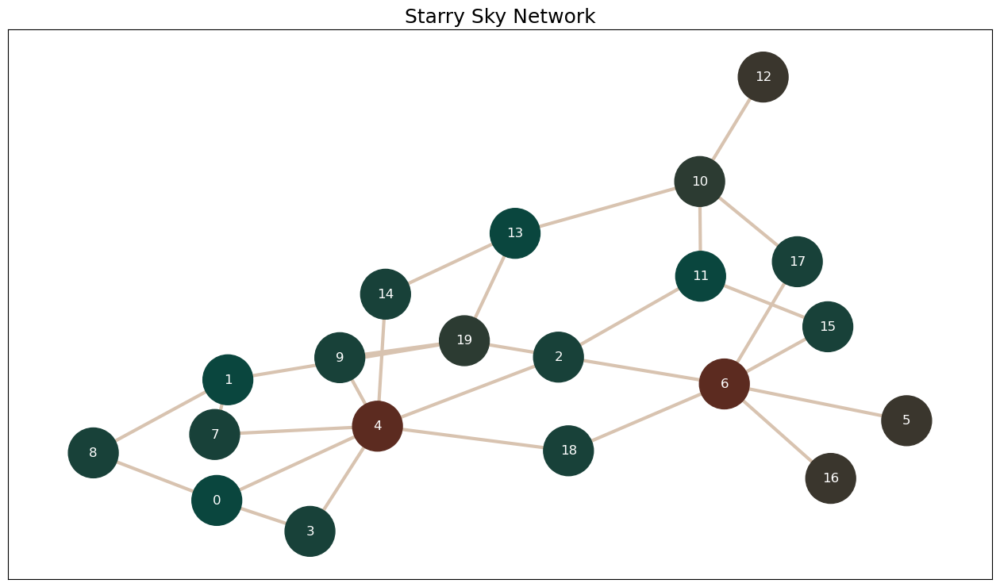

In [10]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network

fig = draw_ligand_network(starry_sky_network, title=starry_sky_network.name);

## 2. Using Real World Data

In the next example, we build a network based on a real world case.

We take the chemical molecules from our [Kartograf publication](https://pubs.acs.org/doi/10.1021/acs.jctc.3c01206) and create mappings between them using Kartograf's [`AtomMapper`](https://kartograf.readthedocs.io/en/latest/guide/atom_mapping.html) and its RMSD-based [`AtomMappingScorer`](https://kartograf.readthedocs.io/en/latest/api/kartograf.metrics.html#kartograf.mapping_metrics.metric_mapping_rmsd.MappingRMSDScorer).

Additionally we demonstrate the interactive widget, that gives immediatley insights into the `Component`s and `AtomMapping`s of a Network.

### Fetching the input data and building the `AtomMapper` and `AtomMappingScorer` classes

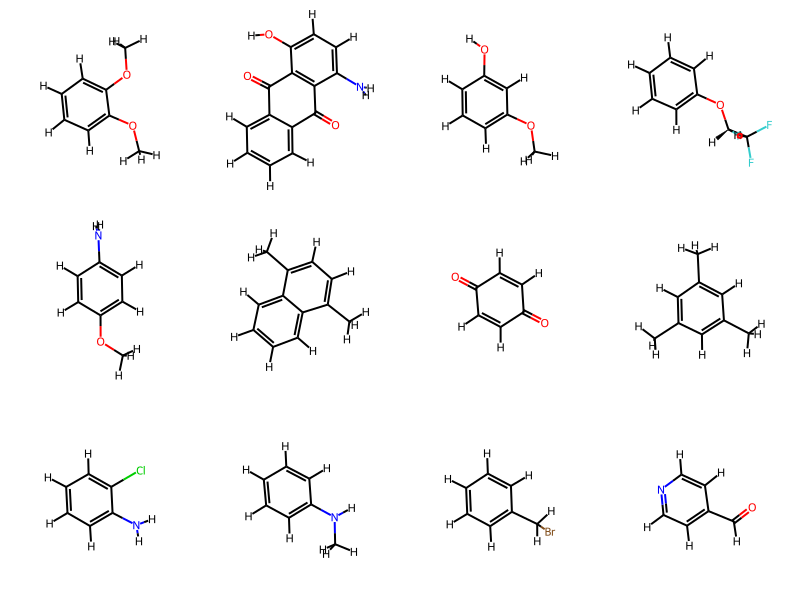

In [11]:
# Getting Data
from rdkit import Chem
from konnektor.data import get_benzene_ligands

rw_components = get_benzene_ligands()
rw_components = list(
    filter(lambda x: not x.name in ["lig_2", "lig_3", "lig_4", "lig_7"], rw_components)
)
Chem.Draw.MolsToGridImage([c.to_rdkit() for c in rw_components], molsPerRow=4)

In [12]:
# Load AtomMapper and Scorer
try:
    from kartograf import KartografAtomMapper, MappingRMSDScorer
except ModuleNotFoundError:  # This will attempt to install kartograf
    !{sys.executable} -m pip install git+https://github.com/OpenFreeEnergy/kartograf.git
    from kartograf import KartografAtomMapper, MappingRMSDScorer

mapper = KartografAtomMapper()
scorer = MappingRMSDScorer()

### Construct __Cyclic Network Layout__
As before, we build the `CyclicNetworkGenerator` passing the `AtomMapper` and `AtomMappingScorer` from Kartograf and use the generator with the components.

In [13]:
from konnektor.network_planners import CyclicNetworkGenerator

network_planner = CyclicNetworkGenerator(
    mappers=mapper, scorer=scorer, n_processes=1
)

cyclic_network_rw = network_planner(rw_components)
cyclic_network_rw.name = "Real World Cyclic Network"
cyclic_network_rw

<LigandNetwork-8d6c43075affce9e3aecc8a2fe6d5866>

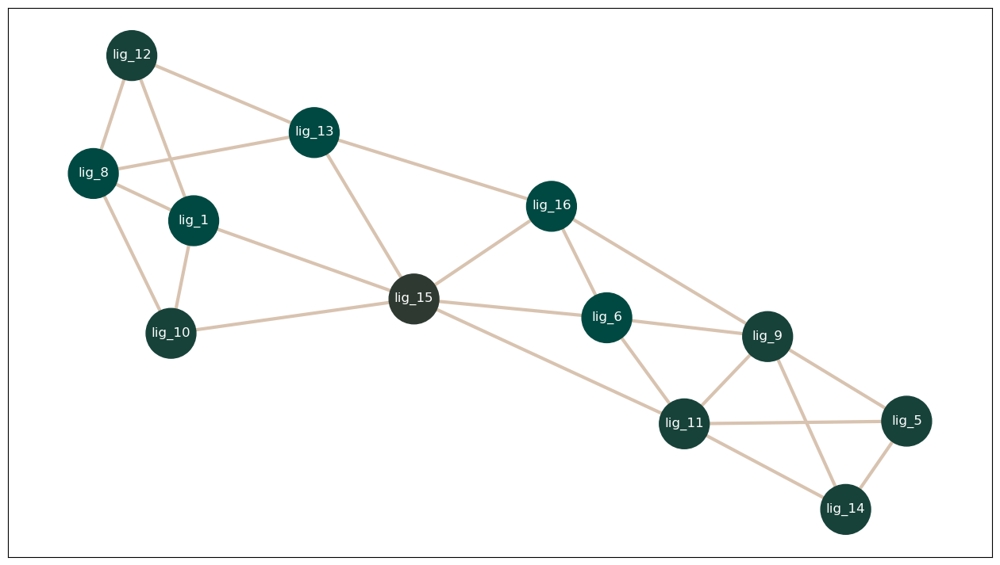

In [14]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network
draw_ligand_network(cyclic_network_rw);

In [15]:
# NBVAL_SKIP
from konnektor.visualization import draw_network_widget

draw_network_widget(cyclic_network_rw, show_molecules=True, show_mappings=True);

interactive(children=(Dropdown(description='layout', index=4, options=('dagre', 'cola', 'breadthfirst', 'conce…

## 3. Advanced Network Generation

After having showed you the basic network generation functionality of Konnektor, let's go beyond that. Konnektor contains a plethora of functions, that can be used to construct, modify or analyse networks.

In the next step we will showcase this functionality by loading a set of potential ligands, that contain a charge change. Our goal here is to build up a network, that is edge efficient but seperates the charges automatically.


### Get Data
First let's load the data:

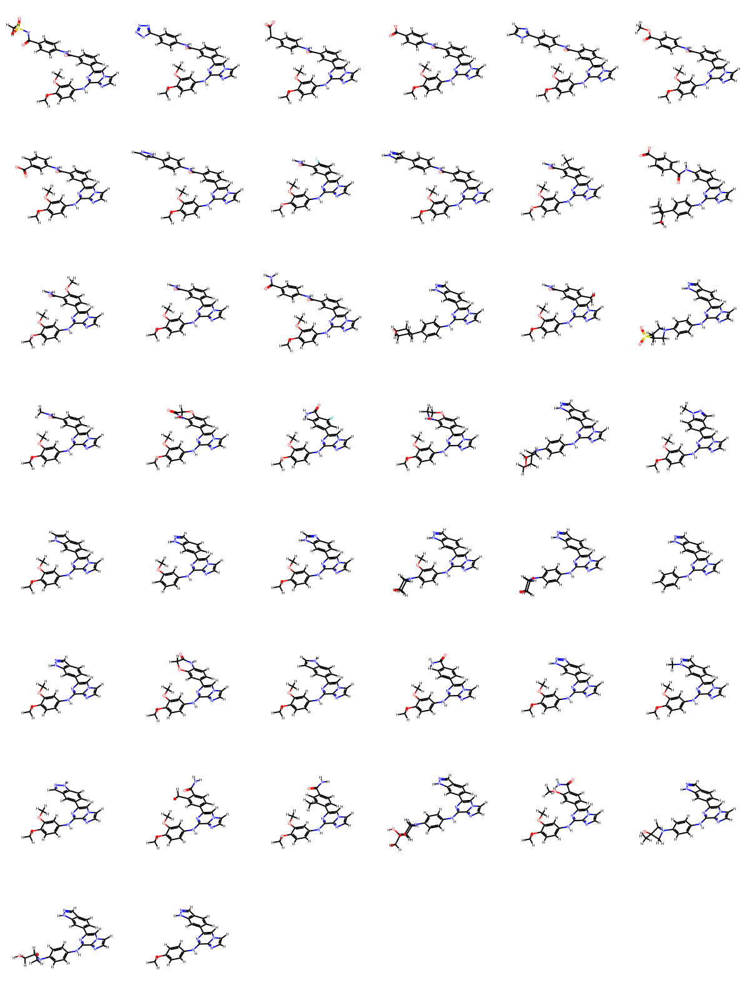

In [16]:
# Getting Data
from rdkit import Chem
from konnektor.data import get_charged_ligands

charge_components = get_charged_ligands()
Chem.Draw.MolsToGridImage([c.to_rdkit() for c in charge_components], molsPerRow=6)

### Generated the Required Scorer
Like with the real world example, we will generate the `AtomMapper` and `AtomMappingScorer` here.

Additionally to the already defined `MappingVolumeRatioScorer` we define here another very simple and crude `charge_scorer`, that captures charge changes and adds a score (please don't use in the real world). We will combine both scores into a `combo_scorer`

In [17]:
# Load AtomMapper and Scorer
# Please note that you will need to install Kartograf for this example to work!
from kartograf import KartografAtomMapper, MappingVolumeRatioScorer

mapper = KartografAtomMapper()

# Define Scorer Combination
volume_scorer = MappingVolumeRatioScorer()

from gufe import AtomMapping


def charge_scorer(atom_mapping: AtomMapping) -> float:
    mA = atom_mapping.componentA.to_rdkit()
    mB = atom_mapping.componentB.to_rdkit()
    cA = Chem.GetFormalCharge(mA)
    cB = Chem.GetFormalCharge(mB)

    dist = min(1, abs(cA - cB))
    return 1 - dist


def combo_scorer(atom_mapping: AtomMapping) -> float:
    return (1 * volume_scorer(atom_mapping) + 2 * charge_scorer(atom_mapping)) / 3

### Build A Clusterer class

Konnektor contains multiple `Clusterer` classes, for seperating `Components` in different ways. Examples include; clustering scaffold, finger print diversity, or charge.

Here we will use the `ChargeClusterer`, which will help us to seperate the molecules by its formal charge.

In [18]:
# Cluster Compounds by charge:
from konnektor.network_tools import ChargeClusterer

clusterer = ChargeClusterer()
clusters = clusterer.cluster_compounds(components=charge_components)

print("Found charges: ", clusters.keys())

Found charges:  dict_keys([-1, 0])


### Build Sub-Networks
Next we will build sub-networks for each cluster, and visualize them.

In [19]:
# Define Cluster Networks:
from konnektor.network_planners import StarNetworkGenerator

ch_radial_networker = StarNetworkGenerator(mappers=mapper, scorer=combo_scorer)
sub_networks = []
for charge, cluster in clusters.items():
    sub_network = ch_radial_networker.generate_ligand_network(cluster)
    sub_networks.append(sub_network)
used_components = [n for sub_network in sub_networks for n in sub_network.nodes]

/tmp/ipykernel_152359/3269336493.py:22: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


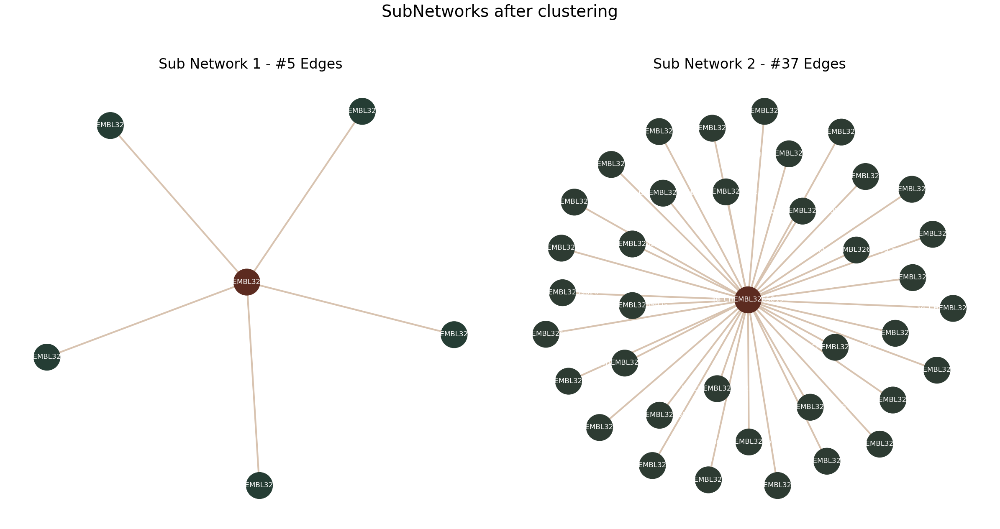

In [20]:
# NBVAL_SKIP
##Visualize sub-networks
from matplotlib import pyplot as plt
from konnektor.visualization import draw_ligand_network

fig = plt.figure(layout="constrained", figsize=[12 * 2, 12])
gs0 = fig.add_gridspec(1, 2)
ax1 = fig.add_subplot(gs0[0])
ax2 = fig.add_subplot(gs0[1])

axes = [ax1, ax2]
i = 1
for ax, sub in zip(axes, sub_networks):
    draw_ligand_network(sub, ax=ax)
    ax.set_title(
        "Sub Network " + str(i) + " - #" + str(len(sub.edges)) + " Edges", fontsize=24
    )
    ax.axis("off")
    i += 1

fig.suptitle("SubNetworks after clustering", fontsize=28, y=1.05)
fig.tight_layout()

### Concatenate the sub-Networks to a final Network

Finally we use the concatenation functionality in Konnektor, that allows you to concatenate two or more networks.

To achieve this a special network planner class type is needed the `NetworkConcatenator`. Here we use the `MstConcatenator` which builds all possilbe edges between two networks and then selects the best scoring `n_connecting_edges` to build the final network.

In [21]:
# NBVAL_SKIP
## Concatenate Sub-Networks
from konnektor.network_tools import concatenate_networks
from konnektor.network_planners import MstConcatenator

concatenator = MstConcatenator(
    mappers=mapper, scorer=combo_scorer, n_connecting_edges=2, n_processes=1
)

charged_starry_sky_network = concatenate_networks(
    networks=sub_networks, concatenator=concatenator
)
charged_starry_sky_network.name = "Starry Sky Network"
charged_starry_sky_network

<LigandNetwork-ecd00b542d28fff8d6fccf64578f3a5f>

This yields a __Charged Starry Sky Network__. 

Visualizing the network you can see how the network consists of two clusters connected by a few edges, reducing the number of net charge changes necessary to explore the network.

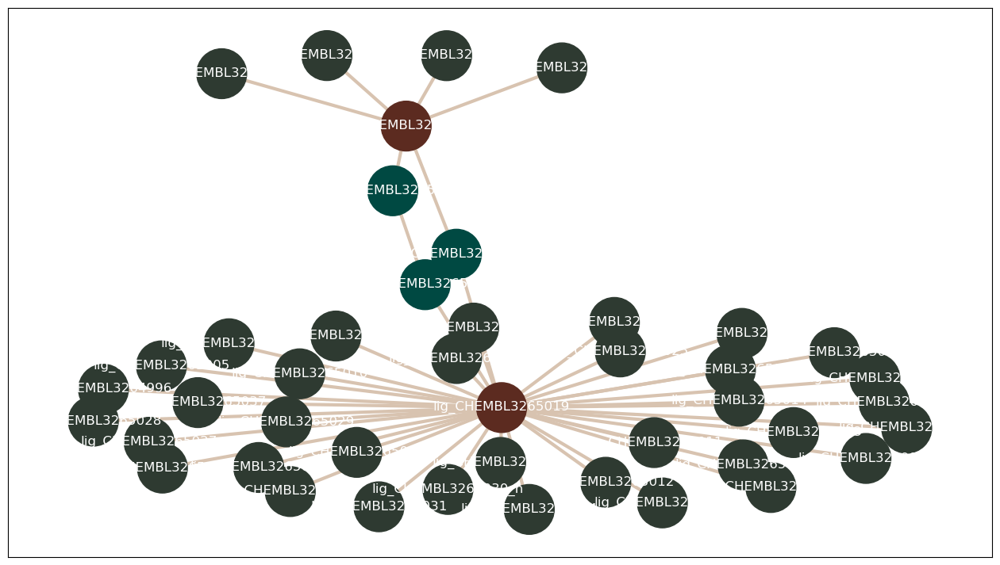

In [22]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network

draw_ligand_network(
    charged_starry_sky_network,
);

#### Interactive visualization wwith the `draw_network_widget`

You can interactively explore this network, and the mappings for each edges, using the `draw_network_widget`.

In [23]:
# NBVAL_SKIP

from konnektor.visualization import draw_network_widget

draw_network_widget(charged_starry_sky_network, show_molecules=True, show_mappings=True);

interactive(children=(Dropdown(description='layout', index=4, options=('dagre', 'cola', 'breadthfirst', 'conce…

### Analyzing the generated network:

In the final step, we will compare the generated __Charged Starry Sky Network__ with alternative network layouts. 

#### Generating Additional Networks to compare to.

For our comparison we will generate a global __Star Network__ and a __Redundant MST Network__.


In [24]:
# NBVAL_SKIP

# first let's generate the Star Network (we will use the networker from above).
ch_radial_networker = StarNetworkGenerator(
    mappers=mapper, scorer=combo_scorer, n_processes=1
)
charge_star_network = ch_radial_networker.generate_ligand_network(used_components)
charge_star_network.name = "Star Network"

# And additionally the Cyclic Network
from konnektor.network_planners import RedundantMinimalSpanningTreeNetworkGenerator

ch_rmst_networker = RedundantMinimalSpanningTreeNetworkGenerator(
    mappers=mapper, scorer=combo_scorer, n_processes=1, n_redundancy=2
)
charge_rmst_network = ch_rmst_networker.generate_ligand_network(used_components)
charge_rmst_network.name = "Redundant MST Network"

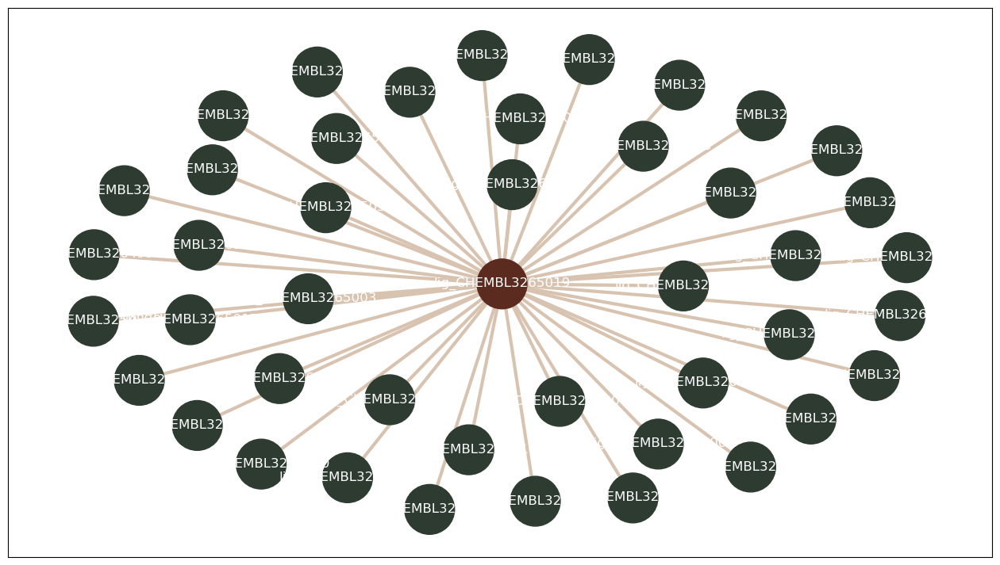

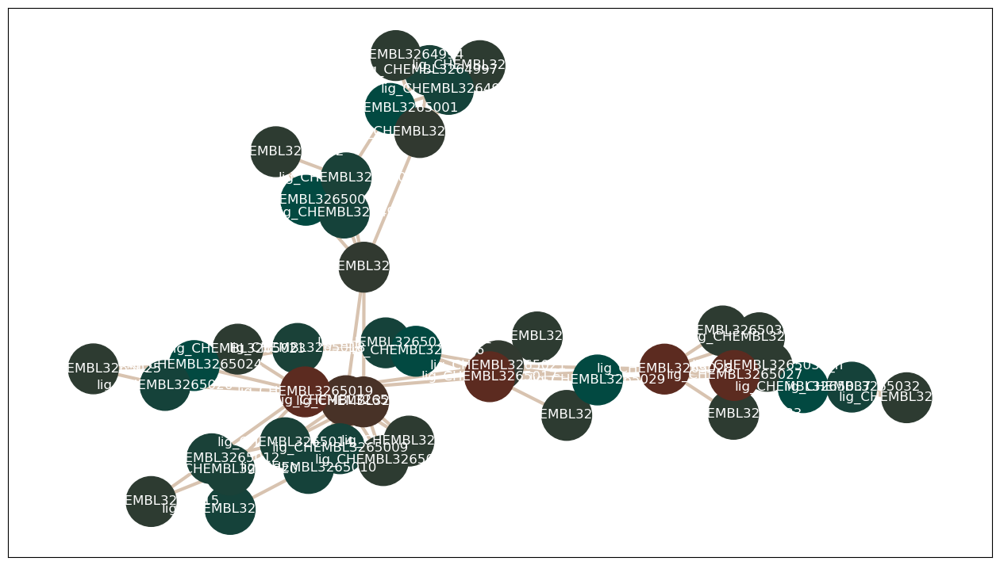

In [25]:
# NBVAL_SKIP

from konnektor.visualization import draw_ligand_network

draw_ligand_network(
    charge_star_network,
)
draw_ligand_network(
    charge_rmst_network,
);

#### Comparing Networks

We can compare our networks using the analysis functions implemented in Konnektor.

**Checking a network is connected:**

We can check that a network is connected using the `get_is_connected` method.

**Counting the number of edges and cycles:**

We can count the number of edges in a network and the number of cycles available using the `get_component_connectivities` and `get_number_of_network_cycles` methods respectively.

**Calculating the Network cost**

We can get the cost of the network, i.e. the sum of all edge scores ($\sum^N_i 1-s^i_e$) using `get_network_cost`.

This metric gives us a rough estimate of the overalll difficulty of all the transformations in the network.

**Calculating graph robustness**

We can evaluate the robustness of a network using `get_transformation_failure_robustness`.
Here robustness checks how resiliant a network is to losing an edge. This is done by randomly removing $1%$ of the edges, evaluating if the graph is still connected and repeating this for 100 times, giving a ratio of how often the graph was still connected.

In [26]:
# NBVAL_SKIP

import numpy as np
from konnektor.network_analysis.network_analysis import (
    get_network_cost,
    get_is_connected,
    get_number_of_network_cycles,
    get_component_connectivities,
    get_transformation_failure_robustness,
)

networks = [charge_star_network, charged_starry_sky_network, charge_rmst_network]

header_format_str = "|{:<30}|{:>22}|{:>22}|{:>22}|"
format_str = "|{:<30}|{:>22.2f}|{:>22.2f}|{:>22.2f}|"

table_str = header_format_str.format("Metric", *[n.name for n in networks]) + "\n"
table_str += header_format_str.format("-" * 30, "-" * 22, "-" * 22, "-" * 22) + "\n"
table_str += (
    header_format_str.format(
        "is connected", *[str(get_is_connected(n)) for n in networks]
    )
    + "\n"
)
table_str += (
    header_format_str.format("number of edges", *[len(n.edges) for n in networks])
    + "\n"
)
table_str += (
    header_format_str.format(
        "number of graph cycles",
        *[int(get_number_of_network_cycles(n)) for n in networks],
    )
    + "\n"
)
table_str += (
    format_str.format(
        "average node connectivity",
        *[np.mean(list(get_component_connectivities(n).values())) for n in networks],
    )
    + "\n"
)
table_str += (
    format_str.format("graph cost", *[get_network_cost(n) for n in networks]) + "\n"
)
table_str += (
    format_str.format(
        "graph robustness",
        *[get_transformation_failure_robustness(n, failure_rate=0.01) for n in networks],
    )
    + "\n"
)

from IPython.display import display, Markdown, Latex

display(Markdown(table_str))

|Metric                        |          Star Network|    Starry Sky Network| Redundant MST Network|
|------------------------------|----------------------|----------------------|----------------------|
|is connected                  |                  True|                  True|                  True|
|number of edges               |                    43|                    44|                    86|
|number of graph cycles        |                     0|                     0|                    42|
|average node connectivity     |                  1.95|                  2.00|                  3.91|
|graph cost                    |                  8.41|                  5.26|                  5.65|
|graph robustness              |                  0.00|                  0.13|                  1.00|


In our comparison the __Star Network__ and the __Starry Sky Network__ have a similar *number of edges* and significantly fewer than the __Redundant MST Network__. If all transformations can be calculated succesfully in the first go, this would mean that the both the __Star Network__ and the __Starry Sky Network__ would require fewer calculations to complete.

However the *graph cost* for the __Star Network__ is significantly higher compared to the __Starry Sky Network__ and the similarly performing __Cyclic Network__. Assuming an accurate scoring metric, this means that the __Star Network__ contains higher difficulty transformations, which may require more samples to converge.

Looking at *graph robustness*, we see that for the __Star Network__ any edge failure leads to the same amount of `Component`s lost in the final ranking. The __Starry Sky Network__ seems to recover from an $1\%$ edge loss in ~ 10% of cases, which does not make it a very robust approach either. Only the __Redundant MST Network__ is able to withstand the $1\%$ edge failure without losing any `Component` in the final ranking. This robustness is an effect from the high *average node connectivity* of the __Redundant MST Network__. An additional interesting aspect of the __Redundant MST Network__ is the large generated number of cycles, which can be used for cycle closure analysis.

A larger comparison of Networks can be found in our pre-print: [Konnektor: A framework for using graph theory to plan networks for free energy calculations](https://chemrxiv.org/engage/chemrxiv/article-details/66d9b574cec5d6c1423643e4)
